# Inspirado en [Paper](https://www.sciencedirect.com/science/article/pii/S0925231219316170)

# Importando librerias

In [1]:
import cv2
import dlib
import os
from PIL import Image
import IPython

import matplotlib
import matplotlib.pyplot as plt
import numpy as np

import torch
import torch.nn as nn
from torch.autograd import Variable
from torchvision import transforms
from torchvision.utils import make_grid
from torch.utils.data import Dataset, DataLoader

import librosa
import librosa.display
from scipy.io import wavfile

device = 'cuda' if torch.cuda.is_available() else 'cpu'

# Tratamiento de datos

## Extracción de caras de los videos

In [ ]:
input_video_path = "/data/data_raw/VideoFlash"
output_images_dir = "/data/data_processed/faces"
os.makedirs(output_images_dir, exist_ok=True)

# Lista con los nombres de los videos
video_files = [f for f in os.listdir(input_video_path) if f.endswith(".flv")]
file_names = []
for names in video_files:
  file_names.append(names.replace(".flv", ""))

# Lista con las rutas a los videos
path_files = [f"{input_video_path}/{f}" for f in os.listdir(input_video_path) if f.endswith(".flv")]

i = 1
for name, video in zip(file_names, path_files):
  print(f"Procesando imagen {name}")
  # Se Iinicializa el detector de rostros de dlib
  detector = dlib.get_frontal_face_detector()

  cap = cv2.VideoCapture(video)
  total_frames = int(cap.get(cv2.CAP_PROP_FRAME_COUNT))

  # Intervalo de muestras
  sample_interval = total_frames // 10
  image_count = 0

  for frame_number in range(total_frames):
      ret, frame = cap.read()

      if not ret:
          break

      # Convierte el fotograma a escala de grises para la detección facial
      gray = cv2.cvtColor(frame, cv2.COLOR_BGR2GRAY)
      faces = detector(gray)

      # Se verifica si se detectó al menos un rostro
      if len(faces) > 0:
          if sample_interval > 0:
              # Toma una muestra en el intervalo definido
              if frame_number % sample_interval == 0:

                  # Obtén las coordenadas de la cara detectada y se recorta
                  x, y, w, h = faces[0].left(), faces[0].top(), faces[0].width(), faces[0].height()
                  face_image = Image.fromarray(cv2.cvtColor(frame[y:y+h, x:x+w], cv2.COLOR_BGR2RGB))
                  resized_face = face_image

                  # Guarda la cara redimensionada en el directorio de salida
                  output_path = os.path.join(output_images_dir, f"{name}.png")

                  # Incrementa el contador de imágenes guardadas
                  image_count += 1

                  # Se detiene el bucle si se han guardado la imagen
                  if image_count == 5:
                      resized_face.save(output_path)
                      print(f"Imagen: {i}")
                      print(f"Imagen guardada {name}.png en {output_images_dir}\n")
                      i = i + 1
                      break

# Libera los recursos
cap.release()

print("Proceso completado. Imágenes guardadas en:", output_images_dir)

Streaming output truncated to the last 5000 lines.
Imagen: 6191
Imagen guardada 1073_IWW_ANG_XX.png en data/data_processed/faces

Procesando imagen 1050_TIE_HAP_XX
Imagen: 6192
Imagen guardada 1050_TIE_HAP_XX.png en data/data_processed/faces

Procesando imagen 1070_IEO_SAD_HI
Imagen: 6193
Imagen guardada 1070_IEO_SAD_HI.png en data/data_processed/faces

Procesando imagen 1066_ITH_HAP_XX
Imagen: 6194
Imagen guardada 1066_ITH_HAP_XX.png en data/data_processed/faces

Procesando imagen 1065_MTI_HAP_XX
Imagen: 6195
Imagen guardada 1065_MTI_HAP_XX.png en data/data_processed/faces

Procesando imagen 1031_IEO_SAD_MD
Imagen: 6196
Imagen guardada 1031_IEO_SAD_MD.png en data/data_processed/faces

Procesando imagen 1077_IWW_DIS_XX
Imagen: 6197
Imagen guardada 1077_IWW_DIS_XX.png en data/data_processed/faces

Procesando imagen 1017_IWW_FEA_XX
Imagen: 6198
Imagen guardada 1017_IWW_FEA_XX.png en data/data_processed/faces

Procesando imagen 1091_IWW_FEA_XX
Imagen: 6199
Imagen guardada 1091_IWW_FEA_XX.

## Transformación de las imagenes

In [ ]:
# Ruta del directorio con las imágenes guardadas
output_images_dir = "/data/data_processed/faces"

# Lista para almacenar los tensores de imagenes y labels
image_tensors = []
label_tensor = []

# Tamaño a re-dimensionar
pixel_size = 144

# Transformaciones para el tensor
transform = transforms.Compose([
    transforms.Resize((pixel_size, pixel_size)),
    transforms.ToTensor(),
    transforms.Normalize(mean=(0,), std=(1,))
])

image_files = [f for f in os.listdir(output_images_dir) if f.endswith(".png")]

for image_file in image_files:
    image_path = os.path.join(output_images_dir, image_file)
    image = Image.open(image_path)

    # Se aplican las transformaciones y se agrega a la lista
    tensor_image = transform(image)
    image_tensors.append(tensor_image)

    # Busca por el nombre de la imagen la emocion y se le asigna el label
    if "ANG" in image_file:
        label_tensor.append(0)
    elif "DIS" in image_file:
        label_tensor.append(1)
    elif "FEA" in image_file:
        label_tensor.append(2)
    elif "HAP" in image_file:
        label_tensor.append(3)
    elif "NEU" in image_file:
        label_tensor.append(4)
    elif "SAD" in image_file:
        label_tensor.append(5)

# Convertimos a un tensor
images_tensor = torch.stack(image_tensors)
labels_tensor = torch.tensor(label_tensor)

print(f"Forma del tensor imágenes resultante: {images_tensor.size()}")
print(f"Forma del tensor labels resultante: {labels_tensor.size()}")

Forma del tensor imágenes resultante: torch.Size([7440, 3, 144, 144])
Forma del tensor labels resultante: torch.Size([7440])


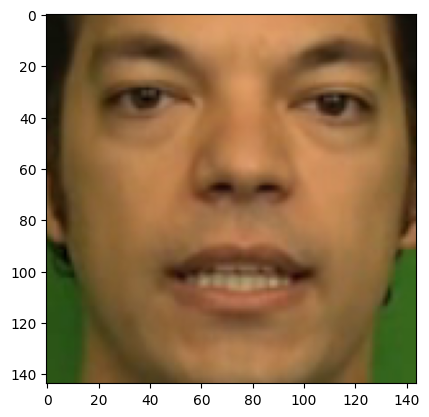

In [ ]:
# Graficamos
images = images_tensor.numpy()
plt.imshow(images[0].transpose((1, 2, 0)), cmap='gray')
plt.show()

## Transformación de audio a espectrograma

Ejemplo de cómo se ve el espectrograma de un audio

In [ ]:
fs, audio = wavfile.read("/data/data_raw/AudioWAV/1001_DFA_ANG_XX.wav")
samples = len(audio)
t = np.arange(0, samples/fs, 1/fs)

plt.figure(figsize=(8,4))

plt.subplot(2, 1, 1)
plt.plot(t, audio)
plt.title('Audio en el dominio del tiempo')
plt.xlabel('Tiempo [s]')
plt.ylabel('Amplitud')
# plt.axis('off')
plt.tight_layout()

plt.subplot(2, 1, 2)
a , b, c, d = plt.specgram(audio, NFFT=1024, Fs=fs, noverlap=512, cmap='jet')
plt.title('Audio espectrograma')
plt.xlabel('Tiempo [s]')
plt.ylabel('Amplitud')
# plt.axis('off')
plt.tight_layout()

plt.show();

Si bien podriamos trabajar con todo el dominio, lo ideal seria recortar hasta solo las partes que más sonido esté presente (aprox 1 segundo de media).

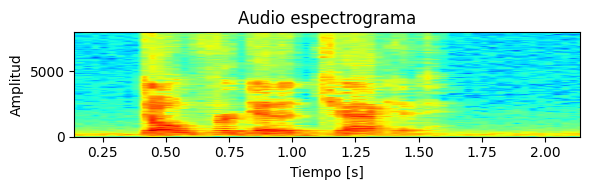

In [6]:
# Calcular la mediana del tiempo
median_time = np.median(t)

# Ajustar el eje x para que esté centrado alrededor de la mediana más/menos 1
time_range = 1
plt_range = [median_time - time_range, median_time + time_range]

plt.figure(figsize=(6,2))
a, _, _, _ = plt.specgram(audio, NFFT=1024, Fs=fs, noverlap=512, cmap='jet')
plt.title('Audio espectrograma')
plt.xlabel('Tiempo [s]')
plt.ylabel('Amplitud')
plt.xlim(plt_range)  # Ajusta el rango del eje x
plt.tight_layout()

plt.show()

Ahora extraemos los espectrogramas de todos los audios y los guardamos

In [ ]:
input_audio_path = "data/data_raw/AudioWAV"
output_audio_dir = "data/data_processed/spectrograms"
os.makedirs(output_audio_dir, exist_ok=True)

# Obtenemos los nombres de los archivos
audio_files = [f for f in os.listdir(input_audio_path) if f.endswith(".wav")]
file_names = []
for names in audio_files:
  file_names.append(names.replace(".wav", ""))

# Obtenemos las rutas de los videos
path_files = [f"{input_audio_path}/{f}" for f in os.listdir(input_audio_path) if f.endswith(".wav")]

i = 1
for name, audio_path in zip(file_names, path_files):
  print(f"Procesando auido {name}")
  fs, audio = wavfile.read(audio_path)
  samples = len(audio)
  t = np.arange(0, samples/fs, 1/fs)

  median_time = np.median(t)
  time_range = 1

  plt.figure(figsize=(6,2))
  plt_range = [median_time - time_range, median_time + time_range]
  a , b, c, d = plt.specgram(audio, NFFT=1024, Fs=fs, noverlap=512, cmap='jet')
  plt.axis('off')

  output_path = os.path.join(output_audio_dir, f"{name}.png")
  plt.ioff()
  plt.savefig(output_path)
  print(f"Imagen: {i}")
  print(f"Imagen guardada {name}.png en {output_audio_dir}\n")
  i += 1

# Dataloader

Creamos nuestro propio dataloader para poder nuestros datos.

In [ ]:
class Dataloader(Dataset):
    def __init__(self, datos, etiquetas):
        self.datos = datos
        self.etiquetas = etiquetas

    def __len__(self):
        return len(self.datos)

    def __getitem__(self, idx):
        dato = self.datos[idx]
        etiqueta = self.etiquetas[idx]
        return dato, etiqueta

In [ ]:
dataset = Dataloader(images_tensor, labels_tensor)

# Arquitecturas DacssGAN

## Generador (G)

### U-NET

In [ ]:
class UNet(nn.Module):
  def __init__(self, input_dim=100, out_dim=(3,28,28),  class_num=6):
    super(UNet, self).__init__()
    self.out_dim = out_dim
    self.input_dim = input_dim
    self.label_emb = nn.Embedding(class_num, class_num)
    self.init = nn.Sequential(nn.Linear(input_dim + class_num, 2352),
                              nn.LeakyReLU(0.2, inplace=True))
    # Capas convolucionales descendentes
    self.down1 = nn.Sequential(nn.Conv2d(3, 64, kernel_size=3, padding=1),
                               nn.BatchNorm2d(64),
                               nn.ReLU(inplace=True))
    self.down2 = nn.Sequential(nn.Conv2d(64, 128, kernel_size=3, padding=1),
                               nn.BatchNorm2d(128),
                               nn.ReLU(inplace=True))
    self.down3 = nn.Sequential(nn.Conv2d(128, 128, kernel_size=3, padding=1),
                               nn.BatchNorm2d(128),
                               nn.ReLU(inplace=True))

    # Capas convolucionales ascendentes
    self.up1 = nn.Sequential(nn.Conv2d(128, 128, kernel_size=3, padding=1),
                               nn.BatchNorm2d(128),
                               nn.ReLU(inplace=True))
    self.up2 = nn.Sequential(nn.Conv2d(128 * 2, 64, kernel_size=3, padding=1),
                               nn.BatchNorm2d(64),
                               nn.ReLU(inplace=True))
    self.up3 = nn.Sequential(nn.Conv2d(64 * 2, out_dim[0], kernel_size=3, padding=1),
                             nn.Tanh())

    # Capas de sub-muestreo y sobre-muestreo
    self.sub = nn.MaxPool2d(2)
    self.sobre = nn.Upsample(scale_factor=2, mode='bilinear', align_corners=True)

  def forward(self, x, labels):
    x = x.view(-1, self.input_dim)
    o_hot = self.label_emb(labels)
    x = torch.cat([x, o_hot], dim=1)
    x = self.init(x)
    x = x.view(-1, self.out_dim[0], self.out_dim[1], self.out_dim[2])

    x1 = self.down1(x)
    x2 = self.down2(self.sub(x1))
    x3 = self.down3(self.sub(x2))

    x4 = self.sobre(self.up1(x3))
    x5 = self.sobre(self.up2(torch.cat([x2, x4], dim=1))) # Skip connection
    x6 = self.up3(torch.cat([x1, x5], dim=1)) # Skip connection
    x6 = x6.view(-1, self.out_dim[0], self.out_dim[1], self.out_dim[2])

    return x6

### EncDec

In [ ]:
class EncDec(nn.Module):
  def __init__(self, input_dim=100, out_dim=(3,28,28), class_num=6):
    super(EncDec, self).__init__()
    self.out_dim = out_dim
    self.input_dim = input_dim
    self.label_emb = nn.Embedding(class_num, class_num)
    # Encoder
    self.enc1 = nn.Sequential(nn.Linear(input_dim + class_num, 1024),
                              nn.LeakyReLU(0.2, inplace=True))
    self.enc2 = nn.Sequential(nn.Linear(1024, 512),
                              nn.LeakyReLU(0.2, inplace=True))

    # Parte intermedia
    self.ib = nn.Sequential(nn.Linear(512, 512),
                            nn.LeakyReLU(0.2, inplace=True))

    # Decoder
    self.dec1 = nn.Sequential(nn.Linear(512, 1024),
                              nn.LeakyReLU(0.2, inplace=True))
    self.dec2 = nn.Sequential(nn.Linear(1024, out_dim[0]*out_dim[1]*out_dim[2]),
                              nn.Tanh())

  def forward(self, x, labels):
    x = x.view(x.shape[0], self.input_dim)
    o_hot = self.label_emb(labels)
    x = torch.cat([x, o_hot], dim=1)
    x = self.enc1(x)
    x = self.enc2(x)

    x = self.ib(x)

    x = self.dec1(x)
    x = self.dec2(x)
    x = x.view(-1, self.out_dim[0], self.out_dim[1], self.out_dim[2])
    return x

### Fully Connected

In [ ]:
class FullyConnected(nn.Module):
  def __init__(self, input_dim=100, out_dim=(3,28,28), class_num=6):
    super(FullyConnected, self).__init__()
    self.out_dim = out_dim
    self.input_dim = input_dim
    self.label_emb = nn.Embedding(class_num, class_num)

    self.fc1 = nn.Sequential(nn.Linear(input_dim + class_num, 256),
                             nn.LeakyReLU(0.2, inplace=True))
    self.fc2 = nn.Sequential(nn.Linear(256, 512),
                             nn.LeakyReLU(0.2, inplace=True))

    # Parte intermedia
    self.ib = nn.Sequential(nn.Linear(512, 512),
                            nn.LeakyReLU(0.2, inplace=True))

    self.fc3 = nn.Sequential(nn.Linear(512, 1024),
                             nn.LeakyReLU(0.2, inplace=True))
    self.fc4 = nn.Sequential(nn.Linear(1024, out_dim[0]*out_dim[1]*out_dim[2]),
                             nn.Tanh())

  def forward(self, x, labels):
    x = x.view(-1, self.input_dim)
    o_hot = self.label_emb(labels)
    x = torch.cat([x, o_hot], dim=1)
    x = self.fc1(x)
    x = self.fc2(x)

    x = self.ib(x)

    x = self.fc3(x)
    x = self.fc4(x)
    x = x.view(-1, self.out_dim[0], self.out_dim[1], self.out_dim[2])
    return x

## Discriminador (D)

### Convolucional

In [ ]:
class DiscriminatorC(nn.Module):
    def __init__(self, input_dim=(3,28,28), class_num=6):
        super(DiscriminatorC, self).__init__()
        self.input_dim = input_dim
        self.label_emb = nn.Sequential(nn.Embedding(class_num, class_num))
        self.conv1 = nn.Sequential(nn.Conv2d(input_dim[0] + class_num, 64, kernel_size=4, padding=1),
                                   nn.BatchNorm2d(64),
                                   nn.LeakyReLU(0.2, inplace=True),)
        self.conv2 = nn.Sequential(nn.Conv2d(64, 128, kernel_size=4, padding=1),
                                   nn.BatchNorm2d(128),
                                   nn.LeakyReLU(0.2, inplace=True),)
        self.conv3 = nn.Sequential(nn.Conv2d(128, 256, kernel_size=4, padding=1),
                                   nn.BatchNorm2d(256),
                                   nn.LeakyReLU(0.2, inplace=True),)
        self.conv4 = nn.Sequential(nn.Conv2d(256, 512, kernel_size=4, padding=1),
                                   nn.BatchNorm2d(512),
                                   nn.LeakyReLU(0.2, inplace=True),)
        self.out = nn.Sequential(nn.Conv2d(512, 1, kernel_size=4, padding=1),
                                 nn.Sigmoid())

    def forward(self, x, labels):
        o_hot = self.label_emb(labels)
        print(o_hot.size())
        o_hot = o_hot.view(o_hot.shape[0], -1 , 1, 1)
        print(o_hot.size())
        o_hot = o_hot.expand(o_hot.size(0), o_hot.size(1), x.size(2), x.size(3))
        print(o_hot.size())
        x = torch.cat([x, o_hot], dim=1)
        x = self.conv1(x)
        x = self.conv2(x)
        x = self.conv3(x)
        x = self.conv4(x)
        x = self.out(x)
        return x.squeeze()

### Fully Connected

In [ ]:
class DiscriminatorFC(nn.Module):
  def __init__(self, input_dim=(3,28,28), class_num=6):
    super(DiscriminatorFC, self).__init__()
    self.input_dim = input_dim
    self.label_emb = nn.Embedding(class_num, class_num)
    self.fc1 = nn.Sequential(nn.Linear(input_dim[0]*input_dim[1]*input_dim[2] + class_num, 1024),
                            nn.LeakyReLU(0.2, inplace=True),
                             nn.Dropout(0.4))
    self.fc2 = nn.Sequential(nn.Linear(1024, 512),
                            nn.LeakyReLU(0.2, inplace=True),
                             nn.Dropout(0.34))
    self.fc3 = nn.Sequential(nn.Linear(512, 256),
                            nn.LeakyReLU(0.2, inplace=True),
                             nn.Dropout(0.4))
    self.fc4 = nn.Linear(256, 1)
    self.sigmoid = nn.Sigmoid()

  def forward(self, x, labels):
    x = x.view(-1, self.input_dim[0]*self.input_dim[1]*self.input_dim[2])
    o_hot = self.label_emb(labels)
    x = torch.cat([x, o_hot], 1)
    x = self.fc1(x)
    x = self.fc2(x)
    x = self.fc3(x)
    x = self.fc4(x)
    x = self.sigmoid(x)
    return x.squeeze()

# Parámetros y configuraciones para el modelo

In [ ]:
# Parámetros
batch_size = 16
learning_rate = 1e-5
epochs = 100
z_size = 100
class_num = 6
image_dim = (3,144,144) # fijarse en las dimensiones de las imagenes que se ocuparán

# Instanciamos modelos, en este caso usaremos EncDec para el egenrador y una FC para el discriminador

generator = EncDec(input_dim=z_size,
                   out_dim=image_dim,
                   class_num=class_num).to(device)

discriminator = DiscriminatorFC(input_dim=image_dim,
                                class_num=class_num).to(device)

# Definimos función de costo y optimizadores
criterion = nn.BCELoss()
optimizer_G = torch.optim.Adam(generator.parameters(), lr=learning_rate)
optimizer_D = torch.optim.Adam(discriminator.parameters(), lr=learning_rate)

# Definimos set de entrenamiento
data_loader = DataLoader(dataset, batch_size=batch_size, shuffle=True)

# Entrenamiento del modelo CGAN

Época: 1
G_loss: 1.2092068195343018, D_loss: 0.19094420969486237


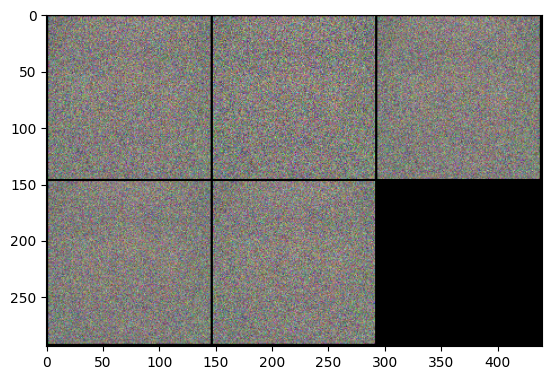



Época: 2
G_loss: 1.2946007251739502, D_loss: 0.17274880409240723


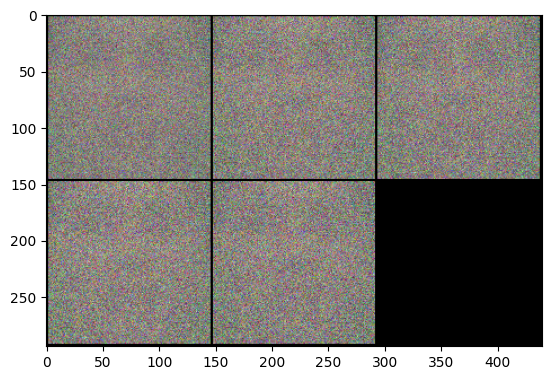



Época: 3
G_loss: 1.6641547679901123, D_loss: 0.11420735716819763


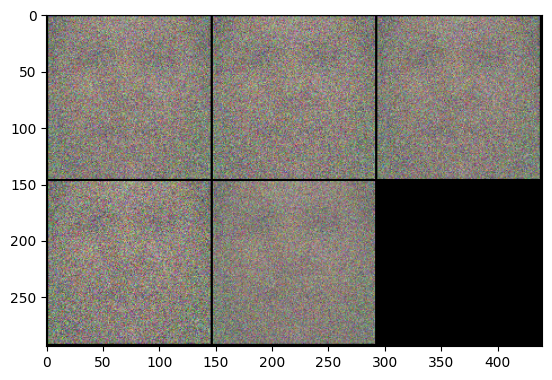



Época: 4
G_loss: 1.523404836654663, D_loss: 0.17054522037506104


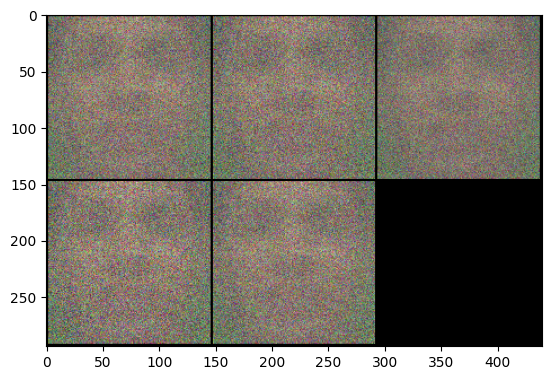



Época: 5
G_loss: 2.0232338905334473, D_loss: 0.1100124716758728


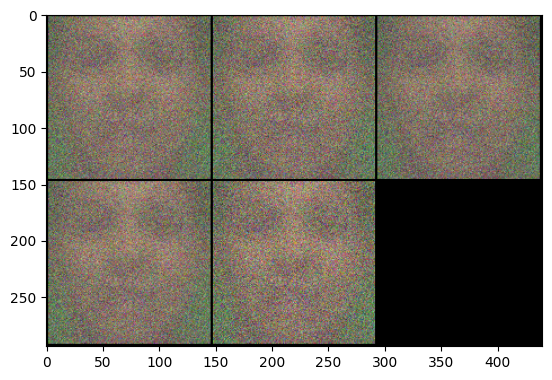



Época: 6
G_loss: 2.3411788940429688, D_loss: 0.09108345955610275


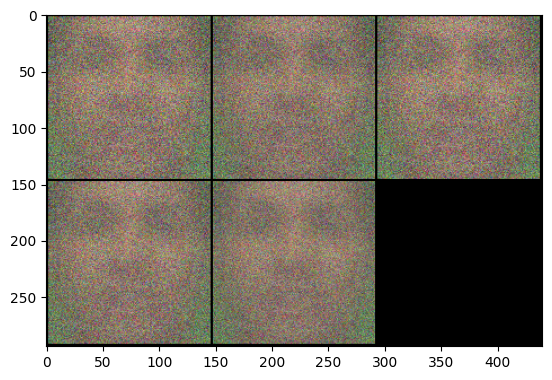



Época: 7
G_loss: 2.796396017074585, D_loss: 0.0926700085401535


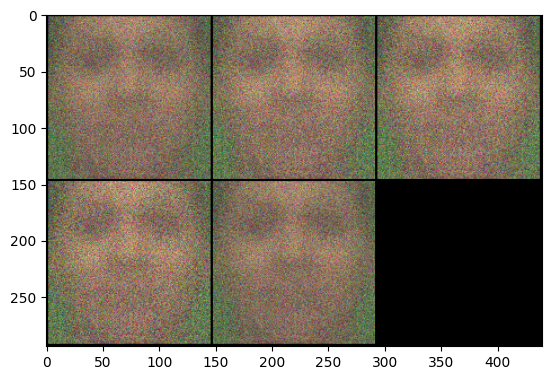



Época: 8
G_loss: 2.301457405090332, D_loss: 0.07952071726322174


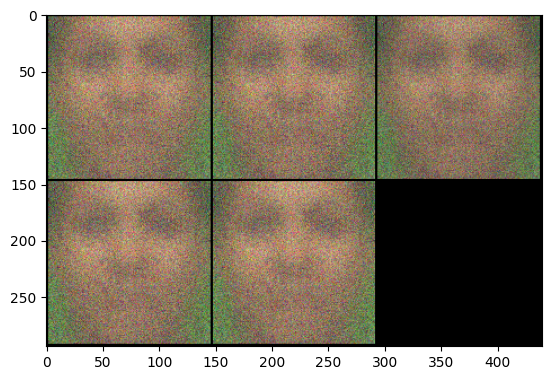



Época: 9
G_loss: 1.811314582824707, D_loss: 0.16561031341552734


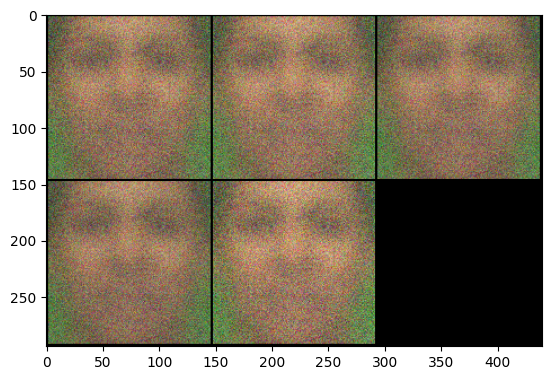



Época: 10
G_loss: 2.6475062370300293, D_loss: 0.25374388694763184


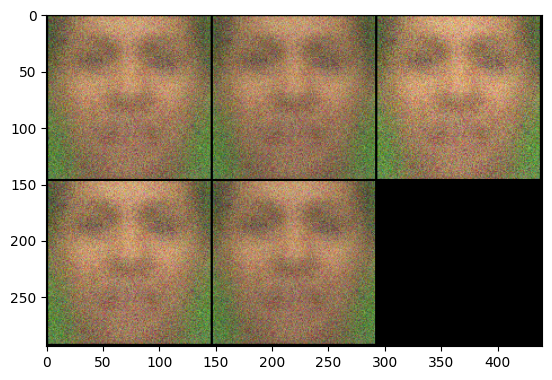



Época: 11
G_loss: 2.8708696365356445, D_loss: 0.2030663937330246


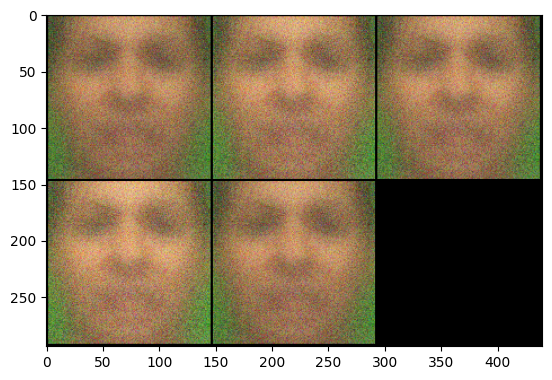



Época: 12
G_loss: 2.913360595703125, D_loss: 0.6085164546966553


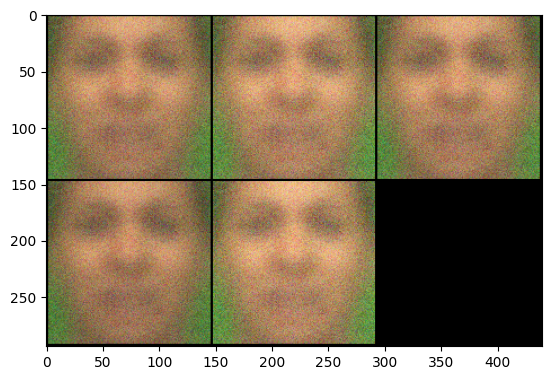



Época: 13
G_loss: 1.4790863990783691, D_loss: 0.3790782690048218


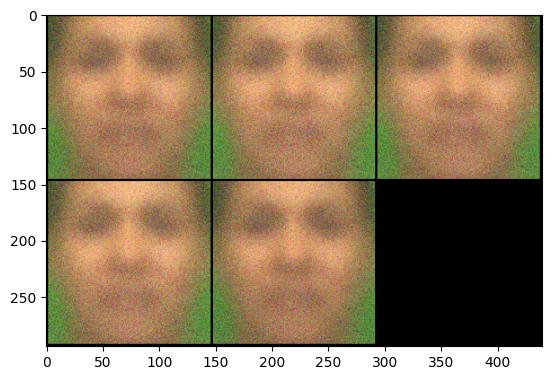



Época: 14
G_loss: 1.1012109518051147, D_loss: 0.4264083206653595


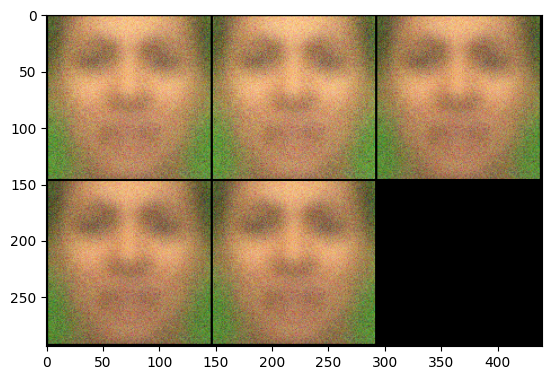



Época: 15
G_loss: 1.580979347229004, D_loss: 0.5677053928375244


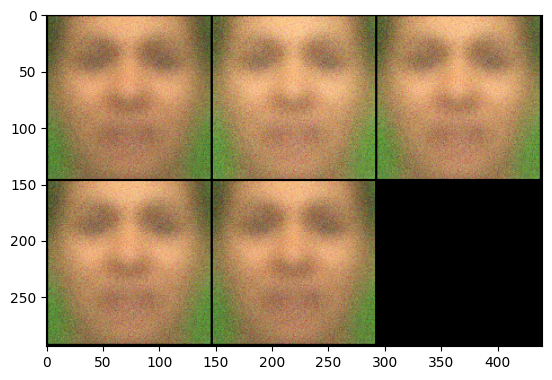



Época: 16
G_loss: 0.9252815246582031, D_loss: 0.5559163689613342


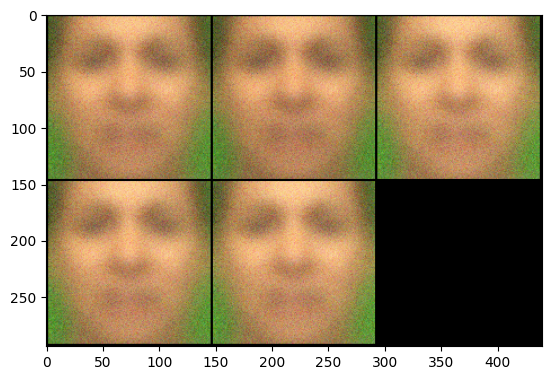



Época: 17
G_loss: 1.547365427017212, D_loss: 0.5191656351089478


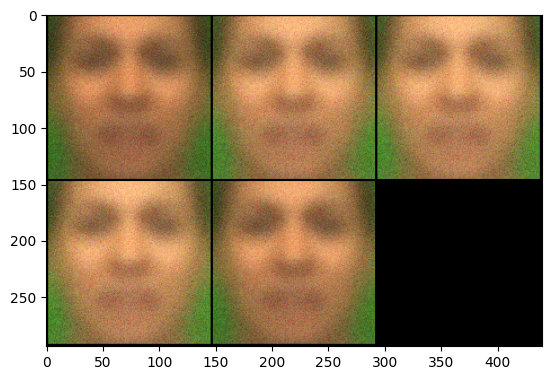



Época: 18
G_loss: 1.117525577545166, D_loss: 0.5149586200714111


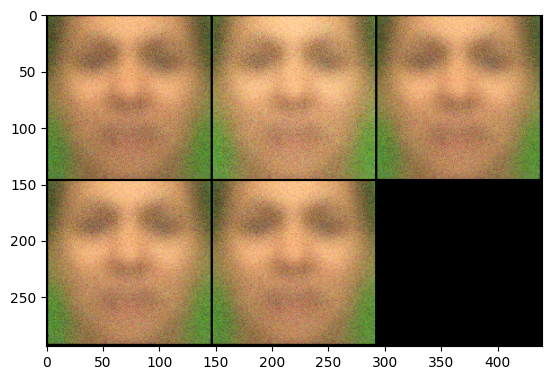



Época: 19
G_loss: 1.5610536336898804, D_loss: 0.4072378873825073


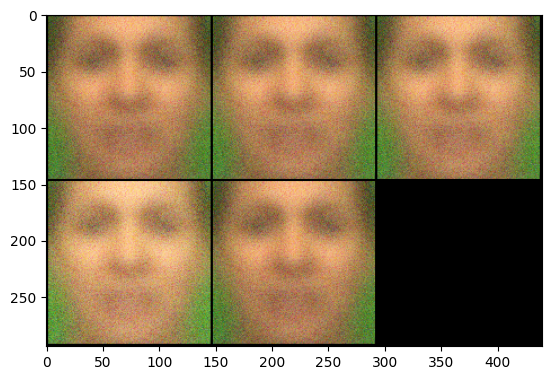



Época: 20
G_loss: 2.5553226470947266, D_loss: 0.5619379878044128


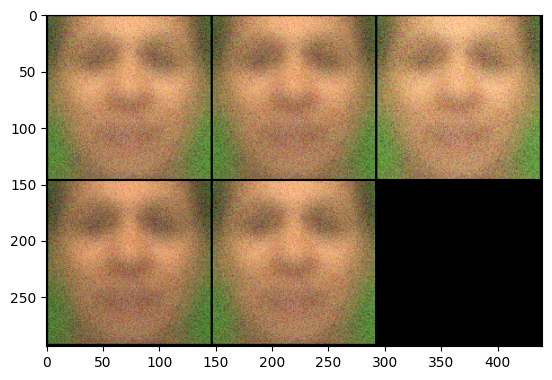



Época: 21
G_loss: 2.9035589694976807, D_loss: 0.45063459873199463


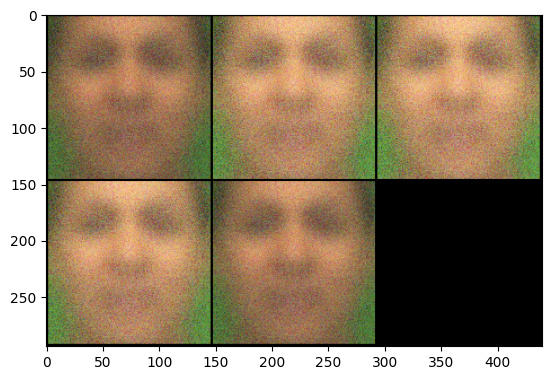



Época: 22
G_loss: 1.374953031539917, D_loss: 0.33951491117477417


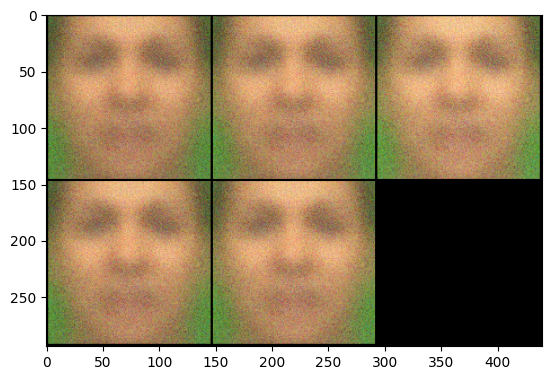



Época: 23
G_loss: 2.6478700637817383, D_loss: 0.2590232491493225


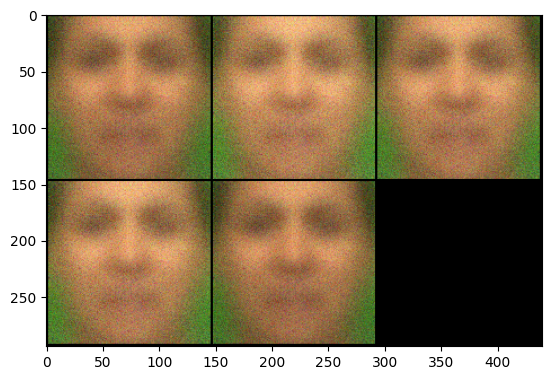



Época: 24
G_loss: 2.3488364219665527, D_loss: 0.5353811979293823


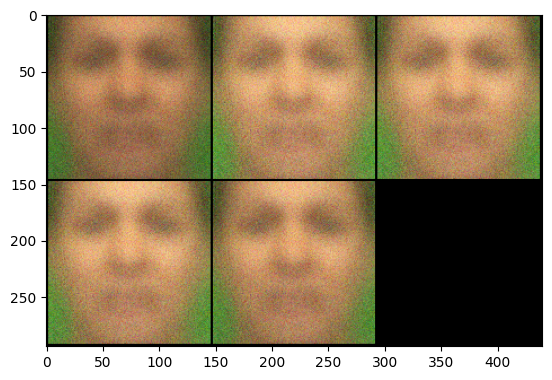



Época: 25
G_loss: 1.6739860773086548, D_loss: 0.4991503357887268


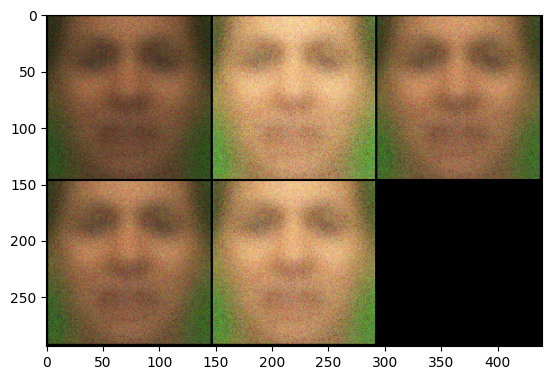



Época: 26
G_loss: 1.1566336154937744, D_loss: 0.4471614956855774


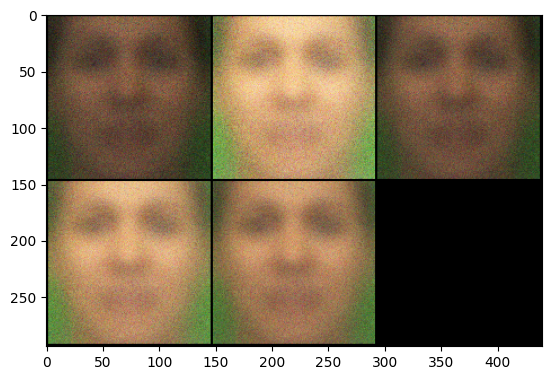



Época: 27
G_loss: 0.9245873093605042, D_loss: 0.4383087754249573


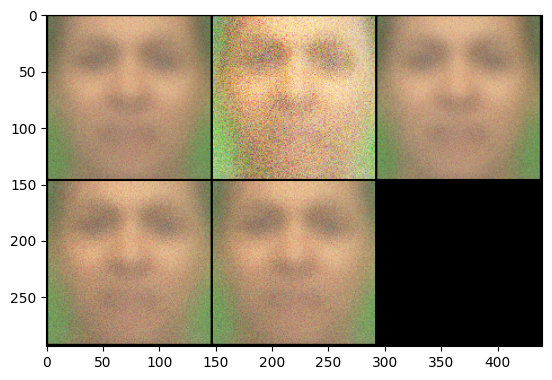



Época: 28
G_loss: 0.6835668087005615, D_loss: 0.7209932804107666


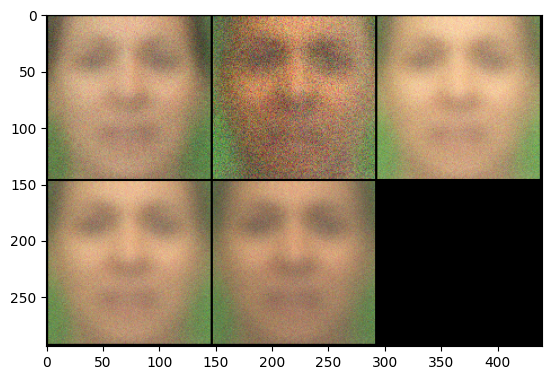



Época: 29
G_loss: 0.8374948501586914, D_loss: 0.6042162179946899


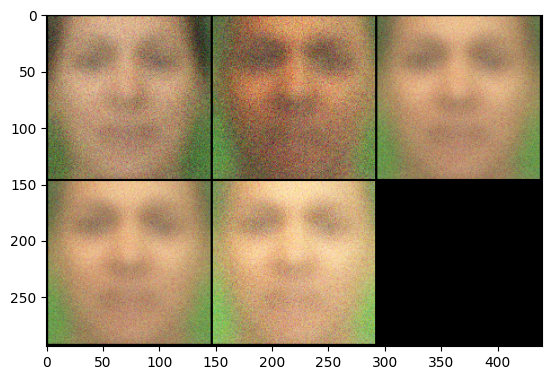



Época: 30
G_loss: 1.0668158531188965, D_loss: 0.5664139986038208


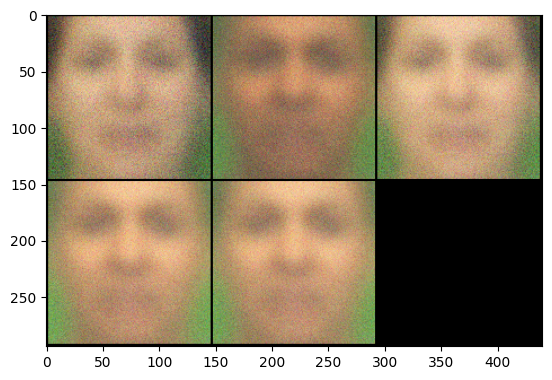



Época: 31
G_loss: 1.1289448738098145, D_loss: 0.5113266110420227


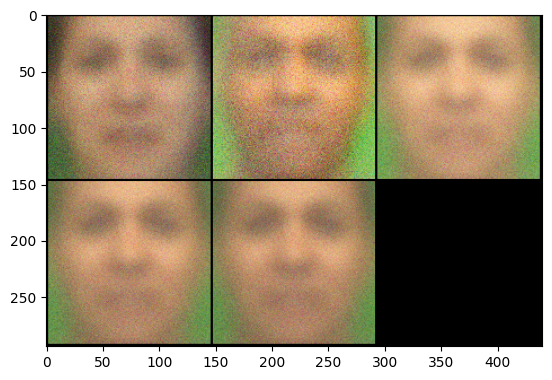



Época: 32
G_loss: 1.5088720321655273, D_loss: 0.4918076992034912


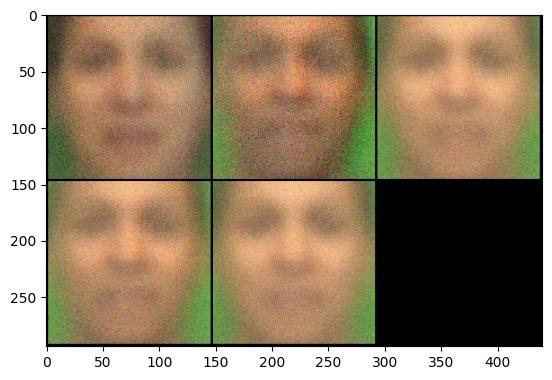



Época: 33
G_loss: 1.2245010137557983, D_loss: 0.7023807764053345


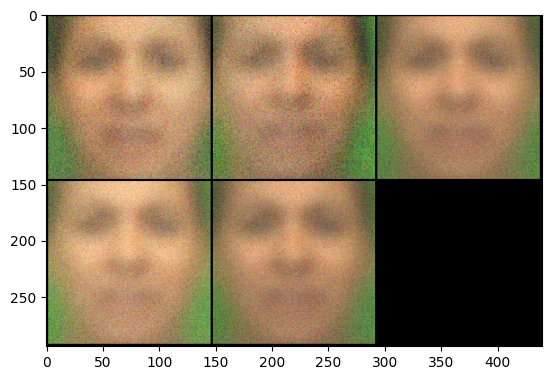



Época: 34
G_loss: 0.5528832674026489, D_loss: 0.768794059753418


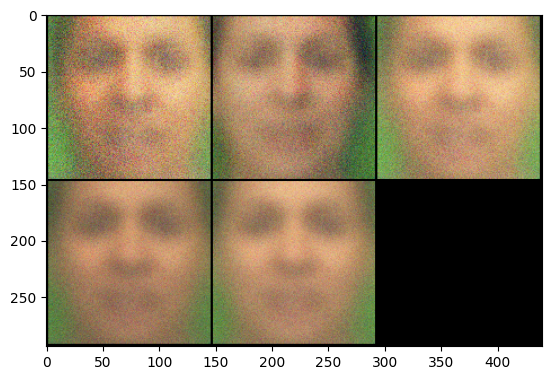



Época: 35
G_loss: 1.2657105922698975, D_loss: 0.538043737411499


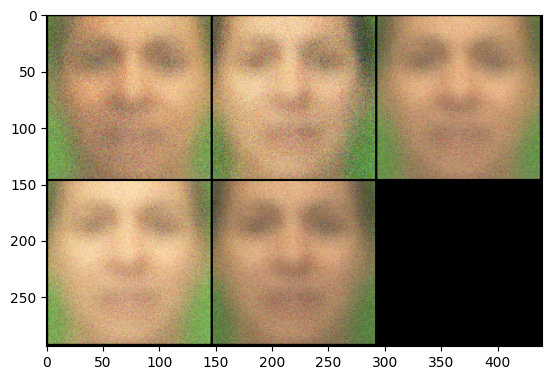



Época: 36
G_loss: 0.6038241386413574, D_loss: 0.6618995666503906


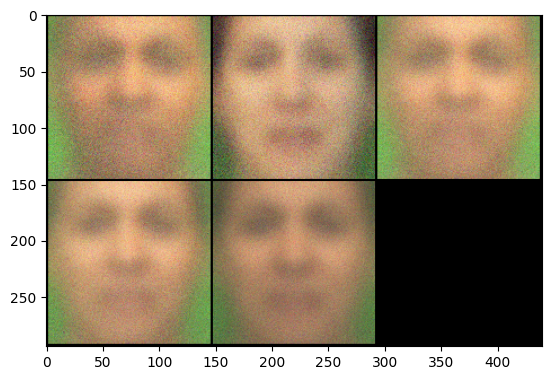



Época: 37
G_loss: 0.6636094450950623, D_loss: 0.6291420459747314


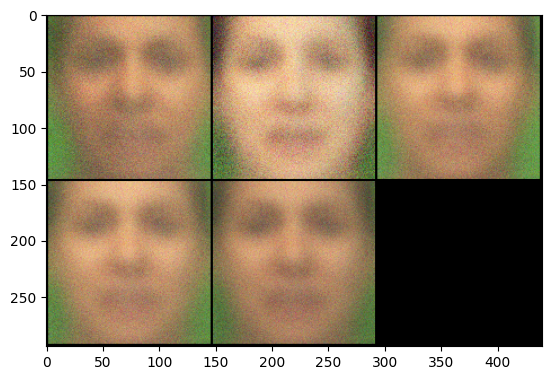



Época: 38
G_loss: 0.787917971611023, D_loss: 0.7072980403900146


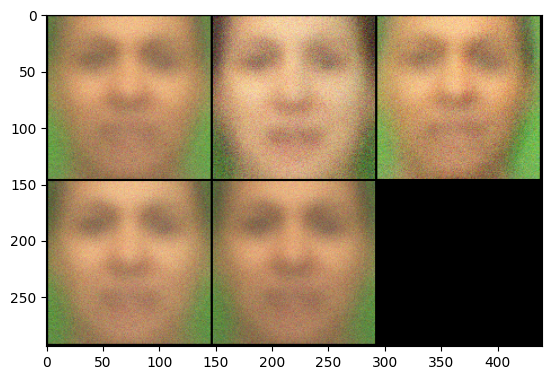



Época: 39
G_loss: 0.7253946661949158, D_loss: 0.6157539486885071


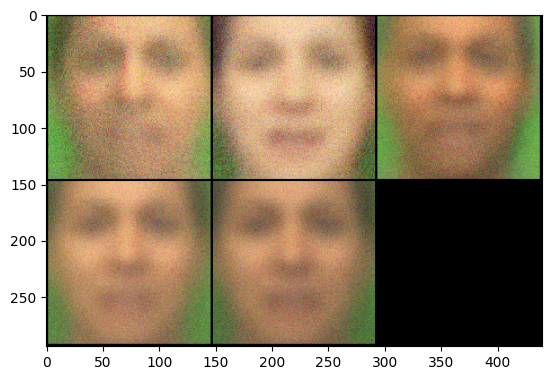



Época: 40
G_loss: 0.7141311168670654, D_loss: 0.8647391200065613


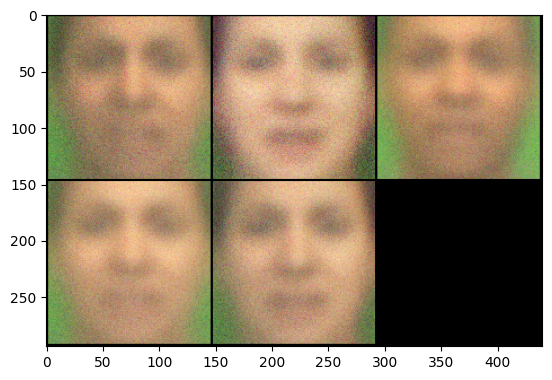



Época: 41
G_loss: 0.6616291999816895, D_loss: 0.6583234071731567


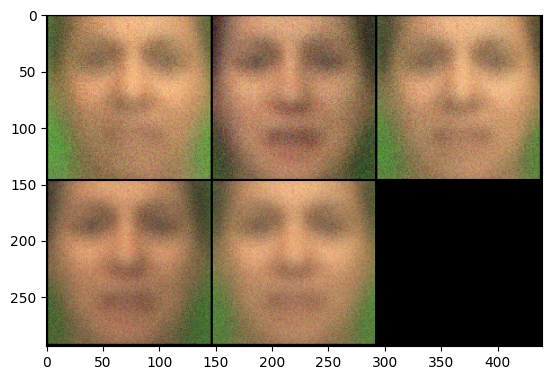



Época: 42
G_loss: 1.1961743831634521, D_loss: 0.5929232835769653


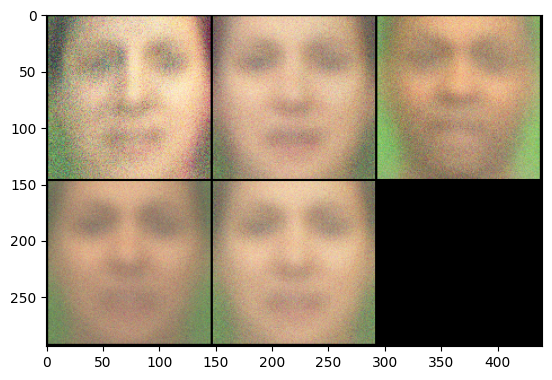



Época: 43
G_loss: 0.9097833037376404, D_loss: 0.7238712310791016


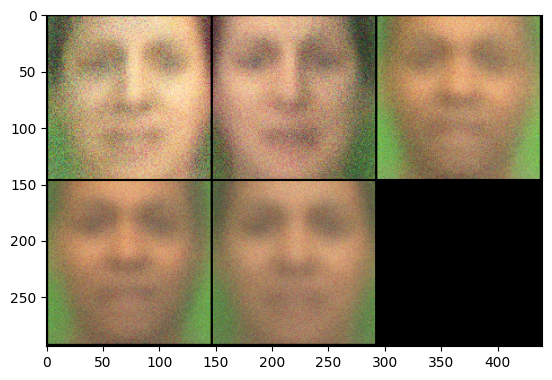



Época: 44
G_loss: 0.8166152238845825, D_loss: 0.6850768327713013


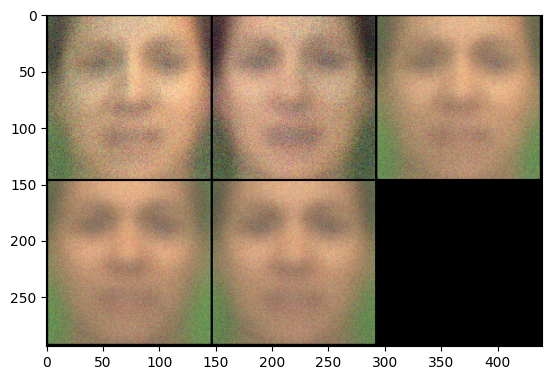



Época: 45
G_loss: 0.8918222188949585, D_loss: 0.6405348181724548


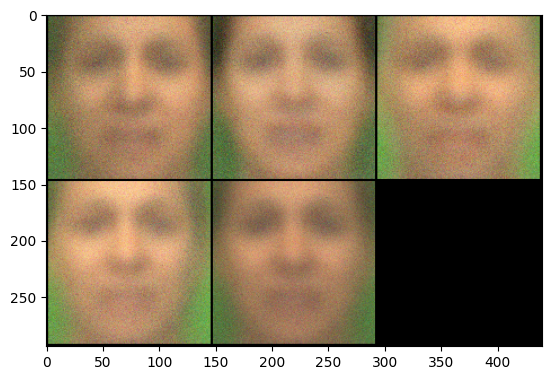



Época: 46
G_loss: 1.0861797332763672, D_loss: 0.5872020125389099


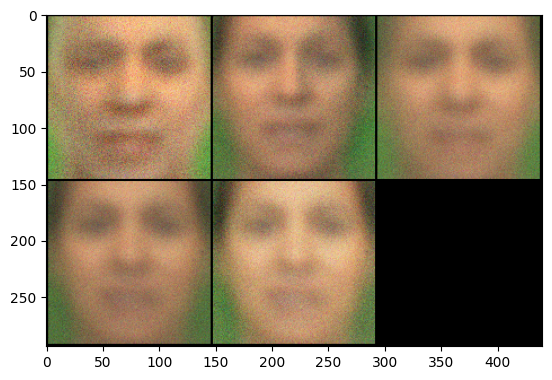



Época: 47
G_loss: 0.5827107429504395, D_loss: 0.7186859250068665


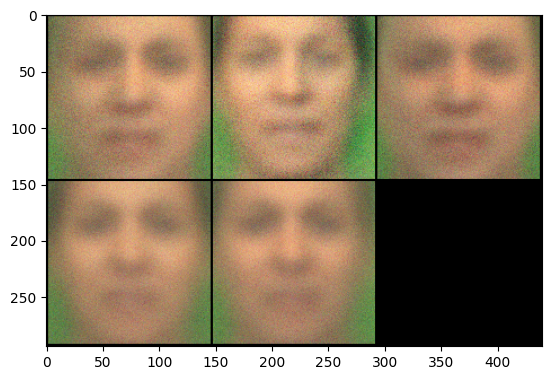



Época: 48
G_loss: 0.7820782661437988, D_loss: 0.6946049928665161


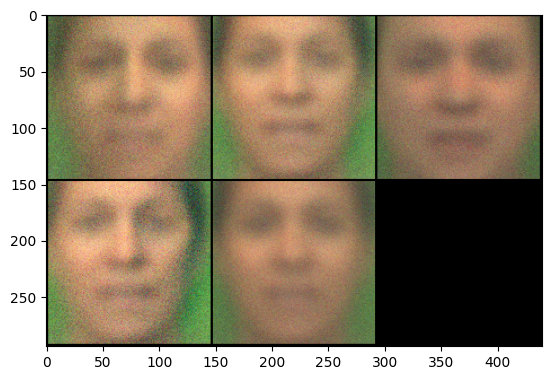



Época: 49
G_loss: 0.668217122554779, D_loss: 0.61398845911026


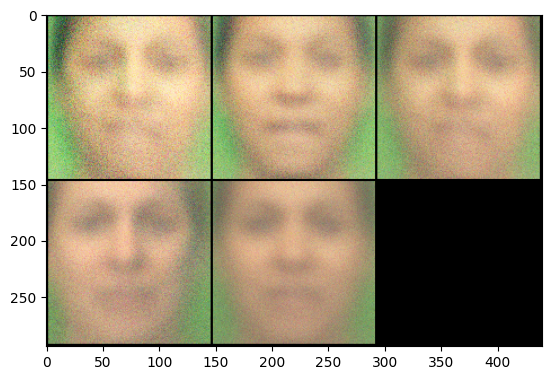



Época: 50
G_loss: 1.1311287879943848, D_loss: 0.6259244680404663


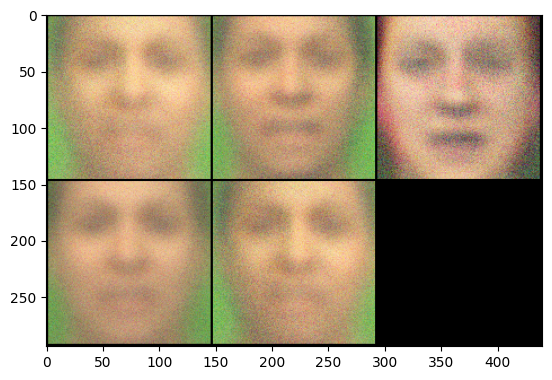



Época: 51
G_loss: 0.746544361114502, D_loss: 0.6577715277671814


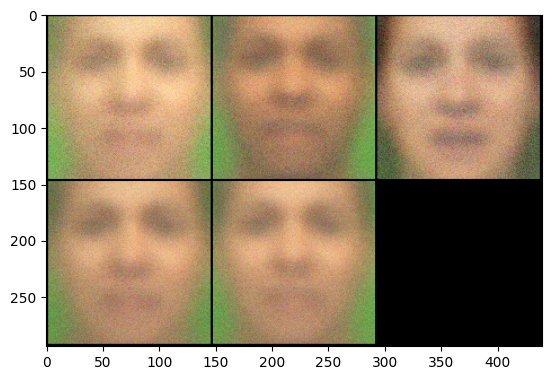



Época: 52
G_loss: 0.7055370807647705, D_loss: 0.7284755706787109


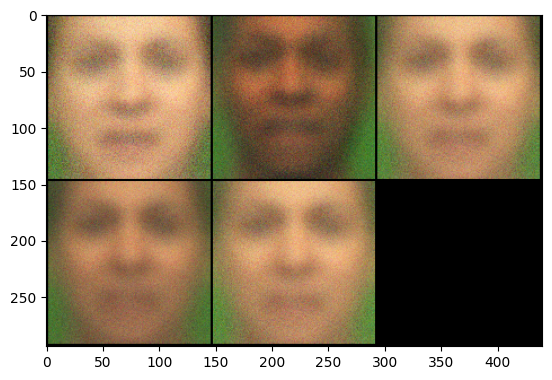



Época: 53
G_loss: 1.0840346813201904, D_loss: 0.6974682211875916


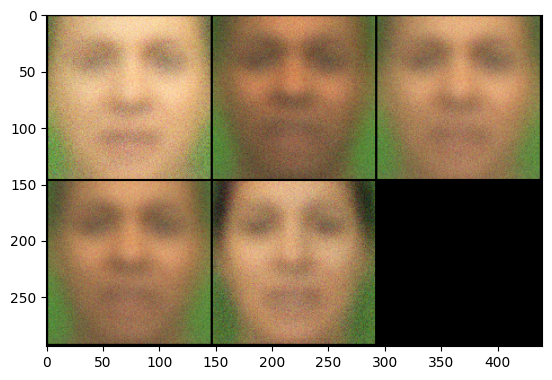



Época: 54
G_loss: 0.6940066814422607, D_loss: 0.6022578477859497


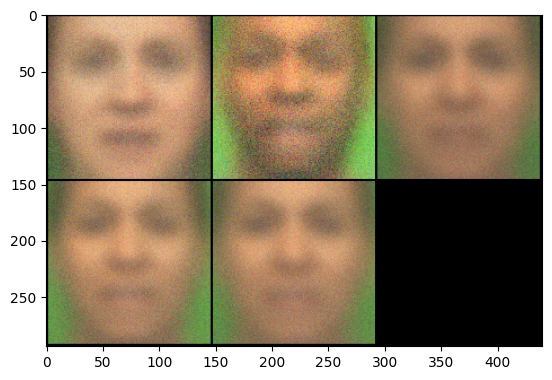



Época: 55
G_loss: 1.1960225105285645, D_loss: 0.5686855912208557


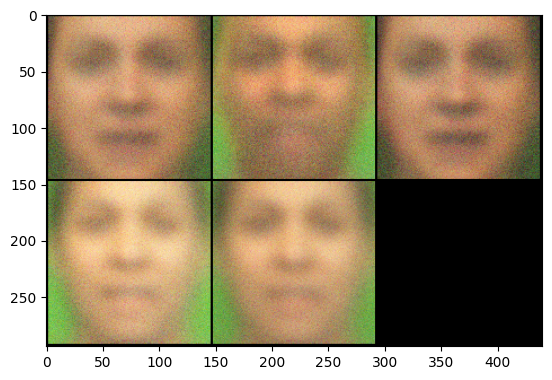



Época: 56
G_loss: 1.0372422933578491, D_loss: 0.646215558052063


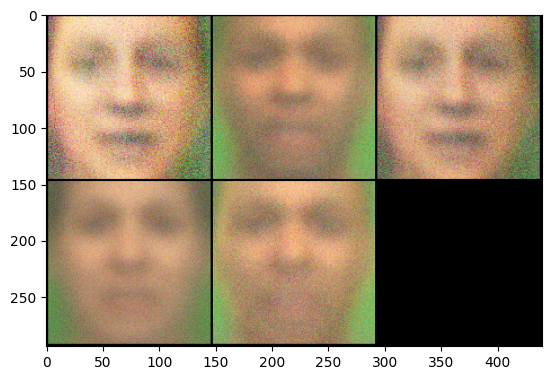



Época: 57
G_loss: 0.755466878414154, D_loss: 0.6413412094116211


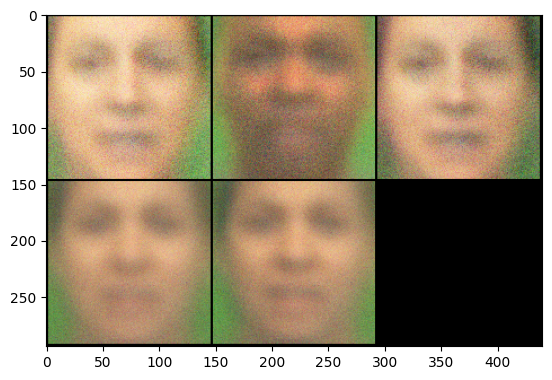



Época: 58
G_loss: 0.721951961517334, D_loss: 0.7219215631484985


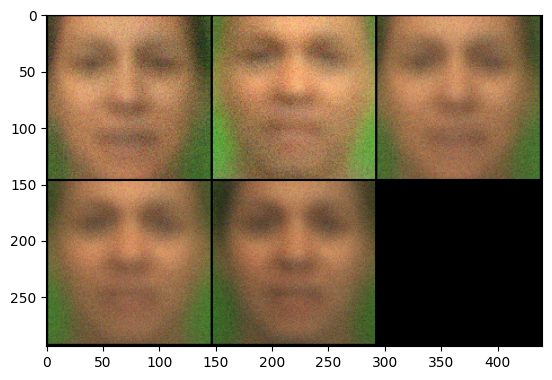



Época: 59
G_loss: 1.196081519126892, D_loss: 0.5706069469451904


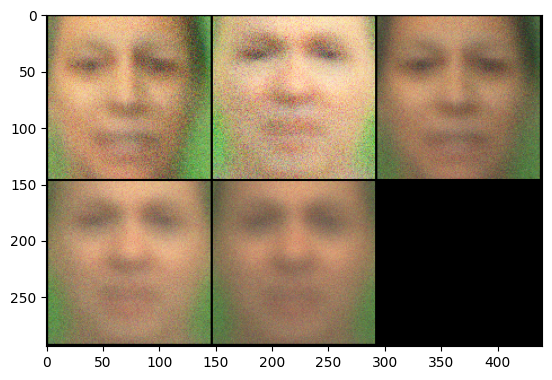



Época: 60
G_loss: 0.6066275835037231, D_loss: 0.7711975574493408


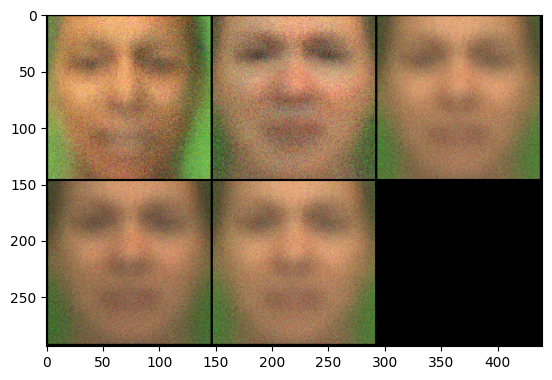



Época: 61
G_loss: 1.7760043144226074, D_loss: 0.6062024235725403


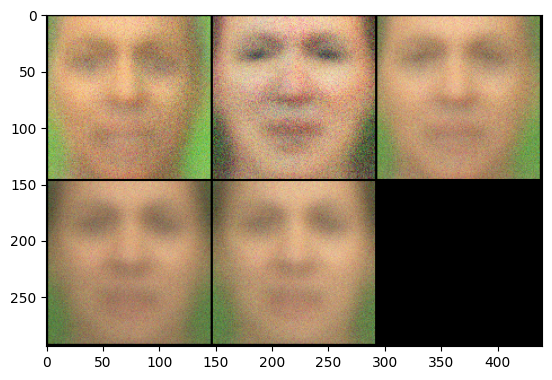



Época: 62
G_loss: 0.708349347114563, D_loss: 0.6026695370674133


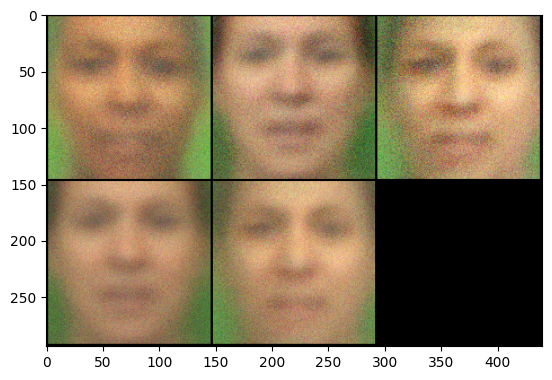



Época: 63
G_loss: 0.6598706245422363, D_loss: 0.6945397853851318


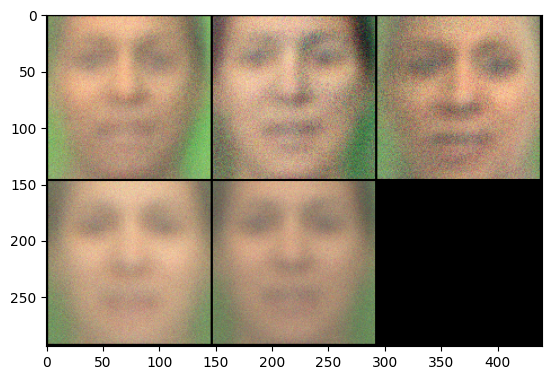



Época: 64
G_loss: 0.6734420657157898, D_loss: 0.6246455907821655


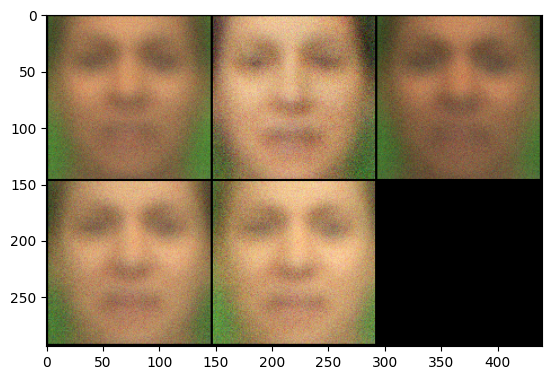



Época: 65
G_loss: 0.6623703837394714, D_loss: 0.670203447341919


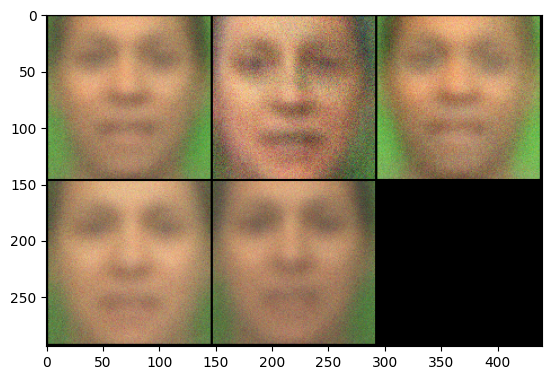



Época: 66
G_loss: 1.8357411623001099, D_loss: 0.5285491347312927


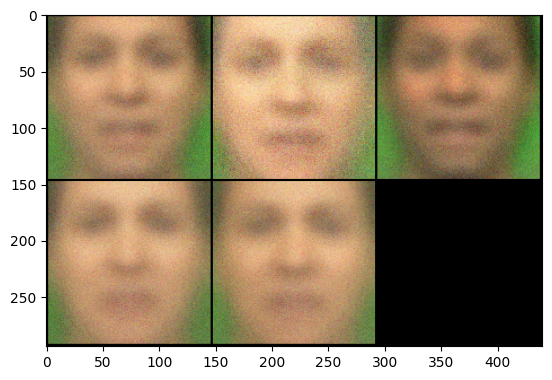



Época: 67
G_loss: 1.0746345520019531, D_loss: 0.6675858497619629


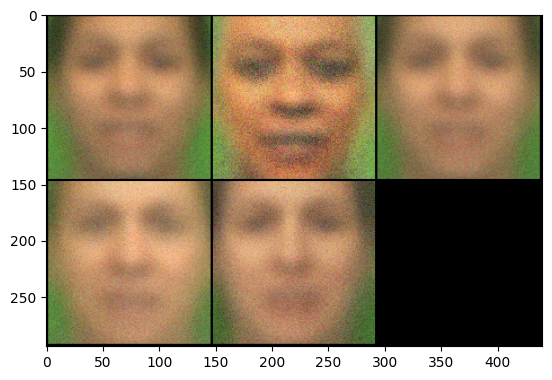



Época: 68
G_loss: 0.7491919994354248, D_loss: 0.6919957995414734


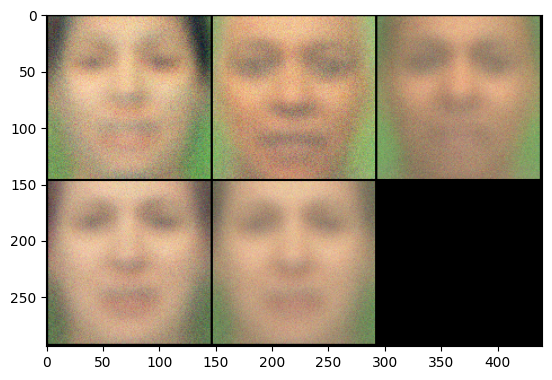



Época: 69
G_loss: 1.0090205669403076, D_loss: 0.5381838083267212


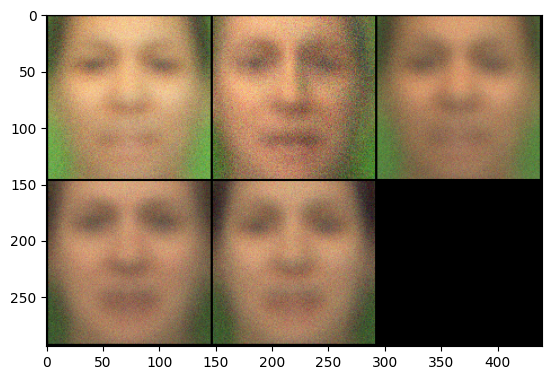



Época: 70
G_loss: 0.9074459075927734, D_loss: 0.7155328392982483


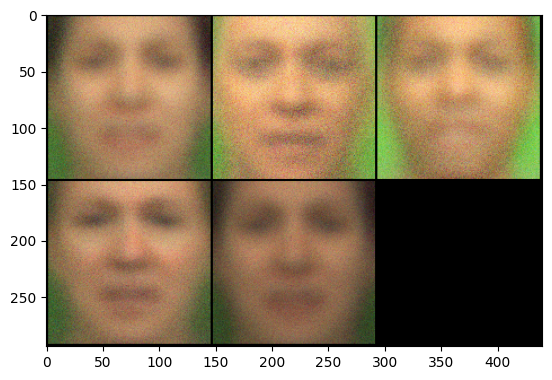



Época: 71
G_loss: 0.6900478005409241, D_loss: 0.7779626846313477


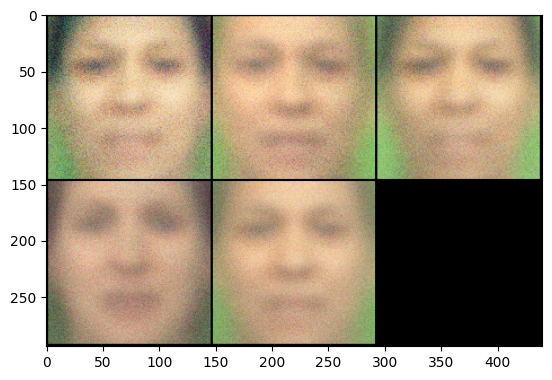



Época: 72
G_loss: 0.9486190676689148, D_loss: 0.6139063835144043


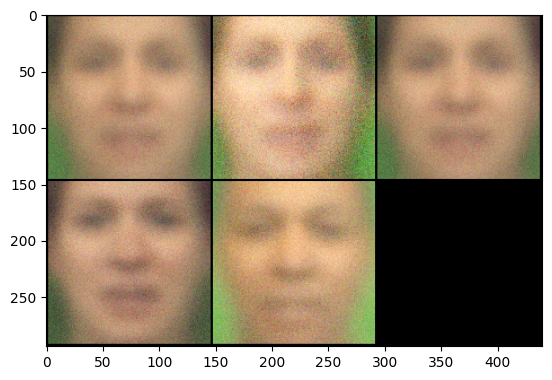



Época: 73
G_loss: 0.8531458377838135, D_loss: 0.5578303337097168


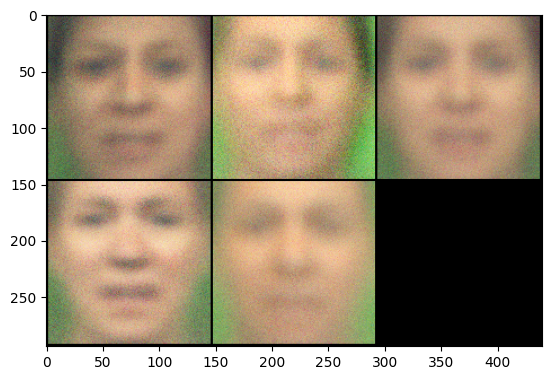



Época: 74
G_loss: 0.6459661722183228, D_loss: 0.6797435879707336


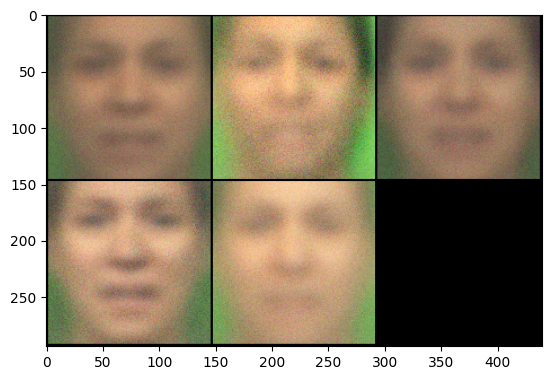



Época: 75
G_loss: 0.6499536037445068, D_loss: 0.7048834562301636


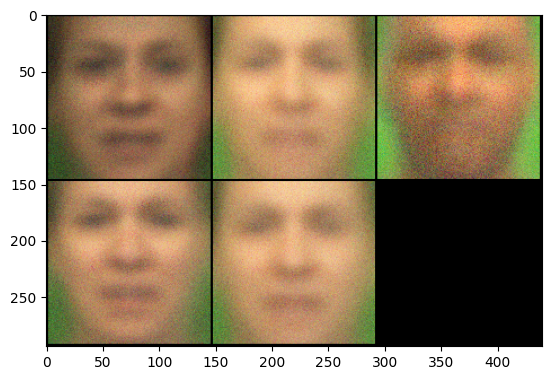



Época: 76
G_loss: 1.0516413450241089, D_loss: 0.6133695840835571


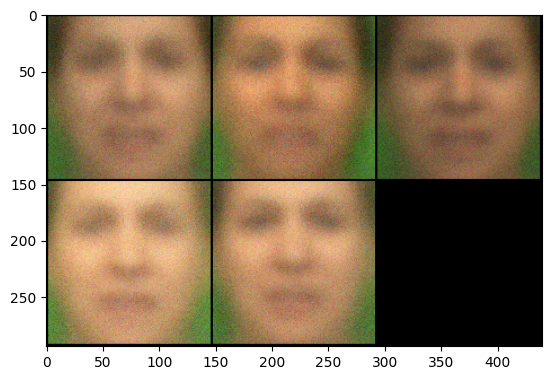



Época: 77
G_loss: 1.0247523784637451, D_loss: 0.6612192392349243


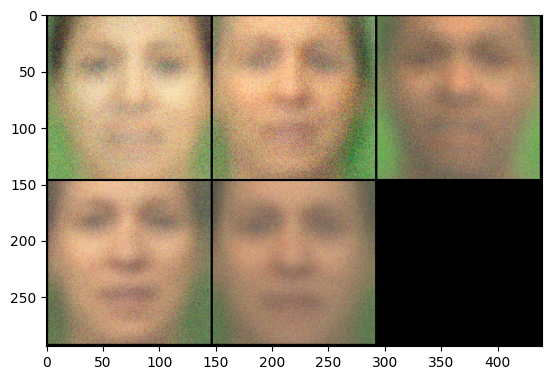



Época: 78
G_loss: 0.8283274173736572, D_loss: 0.624353289604187


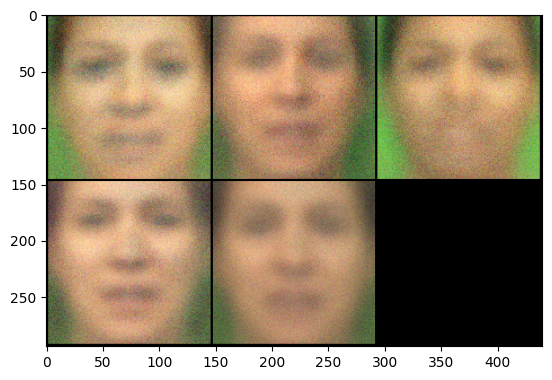



Época: 79
G_loss: 0.5424214601516724, D_loss: 0.7234271764755249


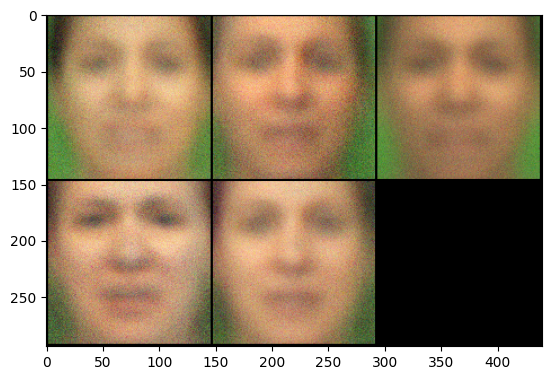



Época: 80
G_loss: 1.0509235858917236, D_loss: 0.6289473176002502


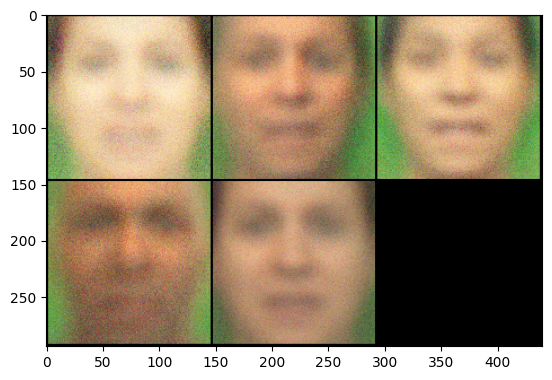



Época: 81
G_loss: 0.5061354041099548, D_loss: 0.7375033497810364


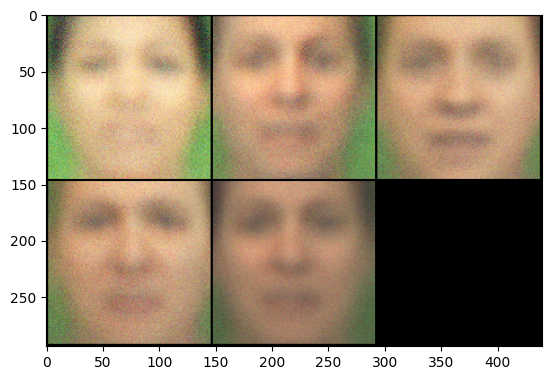



Época: 82
G_loss: 0.6720539331436157, D_loss: 0.743659257888794


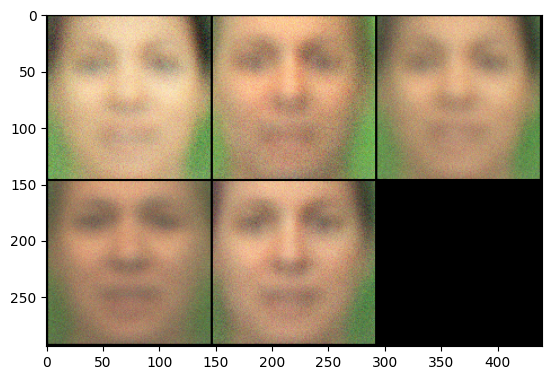



Época: 83
G_loss: 0.9747456312179565, D_loss: 0.6706761121749878


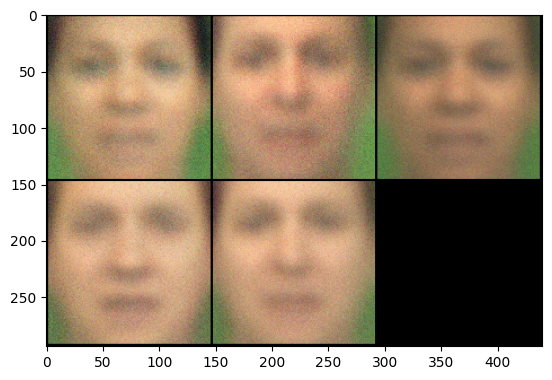



Época: 84
G_loss: 1.1700130701065063, D_loss: 0.6183844804763794


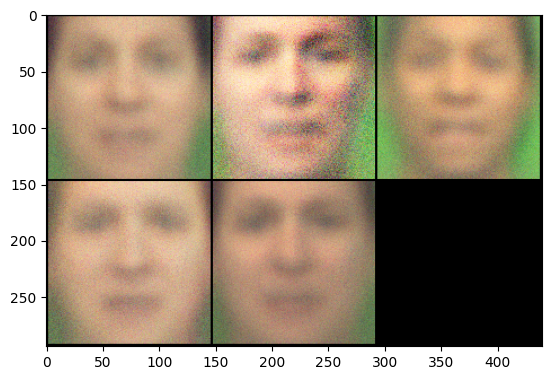



Época: 85
G_loss: 0.6257879734039307, D_loss: 0.7153081297874451


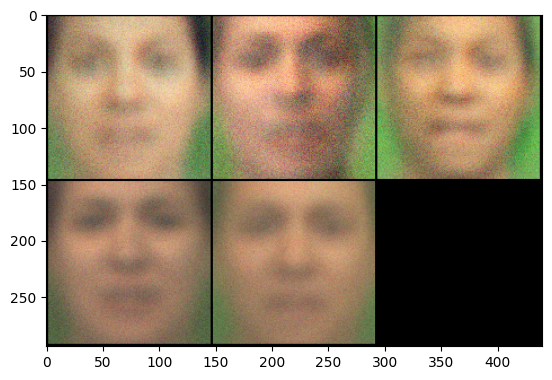



Época: 86
G_loss: 0.8773612380027771, D_loss: 0.6482861638069153


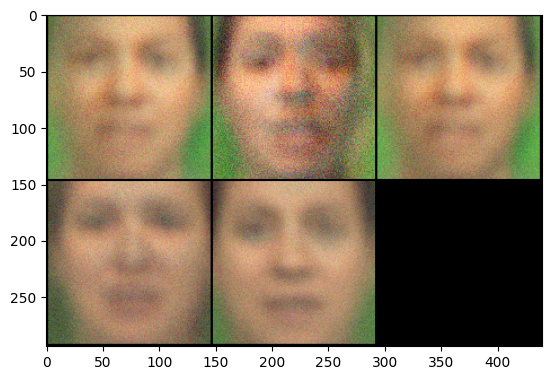



Época: 87
G_loss: 0.48355832695961, D_loss: 0.7024939060211182


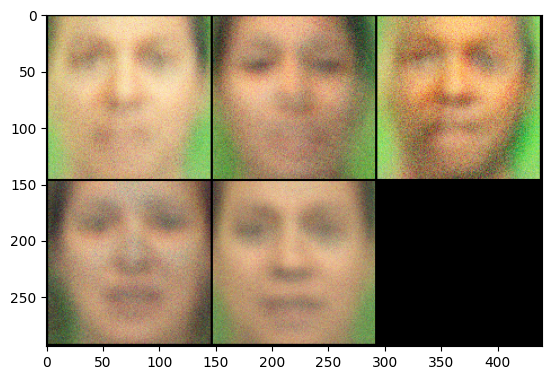



Época: 88
G_loss: 0.8281278610229492, D_loss: 0.6001104116439819


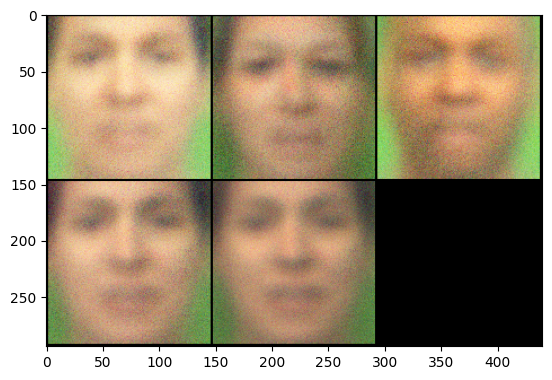



Época: 89
G_loss: 0.6317801475524902, D_loss: 0.7018154859542847


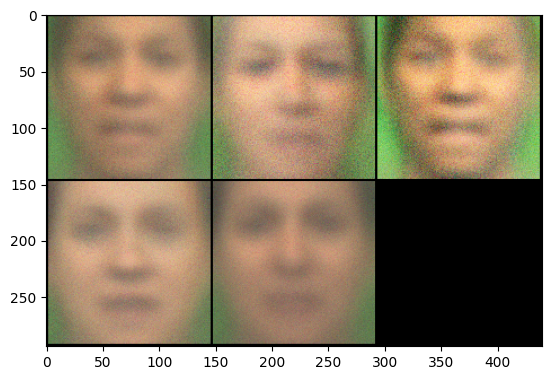



Época: 90
G_loss: 0.5567752122879028, D_loss: 0.6463038921356201


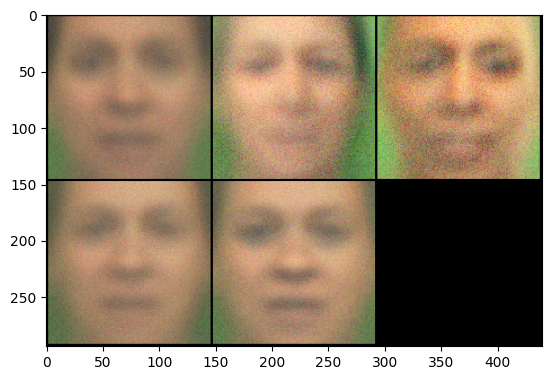



Época: 91
G_loss: 0.6501625776290894, D_loss: 0.7303162813186646


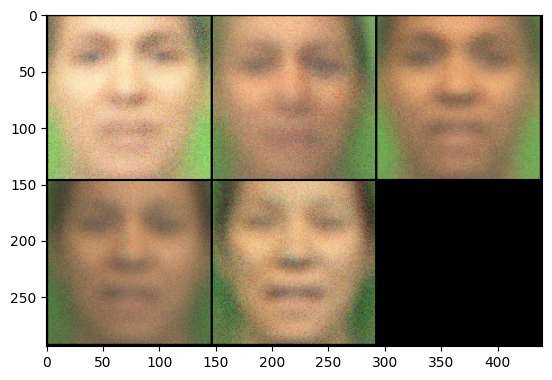



Época: 92
G_loss: 0.7009282112121582, D_loss: 0.7291248440742493


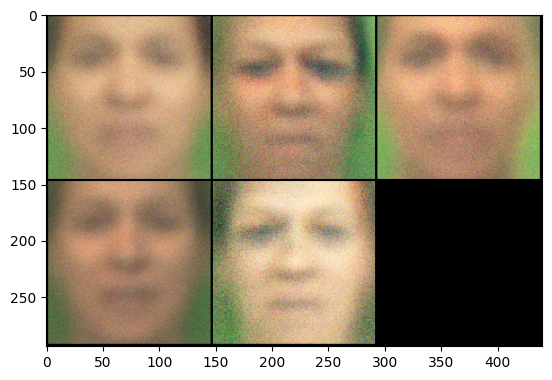



Época: 93
G_loss: 0.6561440825462341, D_loss: 0.6980327367782593


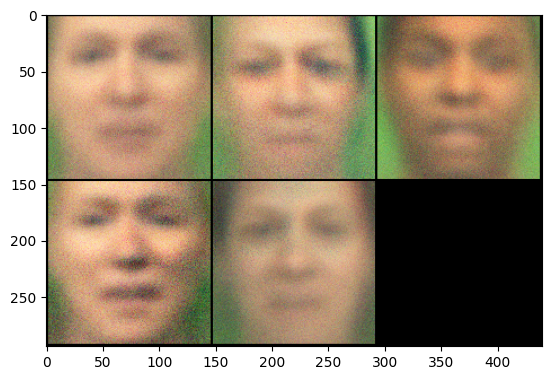



Época: 94
G_loss: 0.9226187467575073, D_loss: 0.6683553457260132


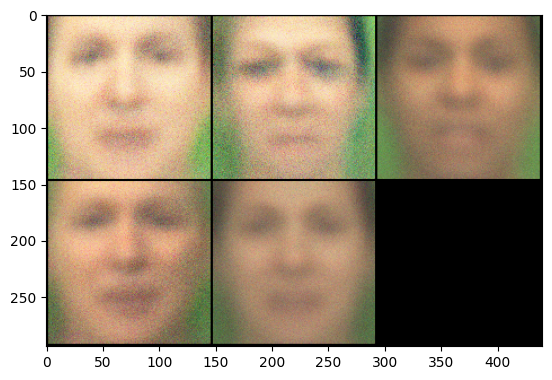



Época: 95
G_loss: 0.554259181022644, D_loss: 0.6537576913833618


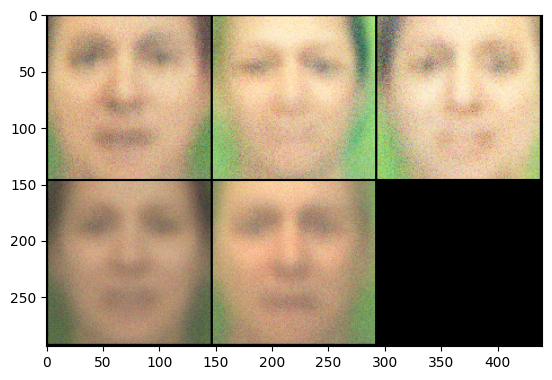



Época: 96
G_loss: 0.7947770357131958, D_loss: 0.7271562814712524


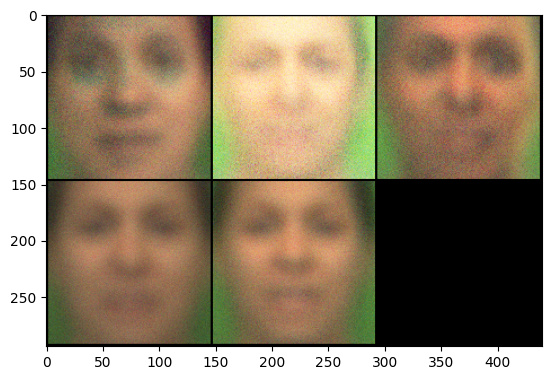



Época: 97
G_loss: 0.5086946487426758, D_loss: 0.686777651309967


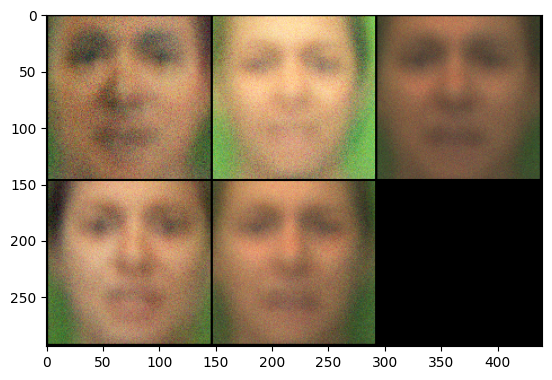



Época: 98
G_loss: 0.821931779384613, D_loss: 0.6950710415840149


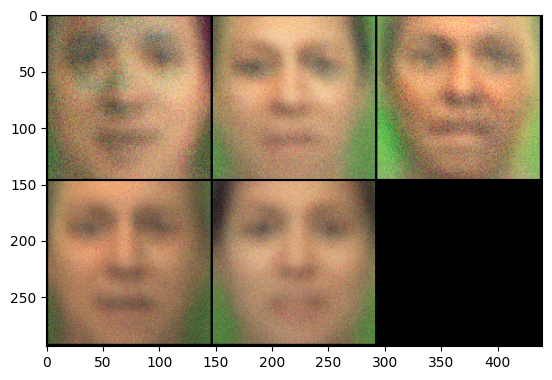



Época: 99
G_loss: 0.7942121028900146, D_loss: 0.7497366070747375


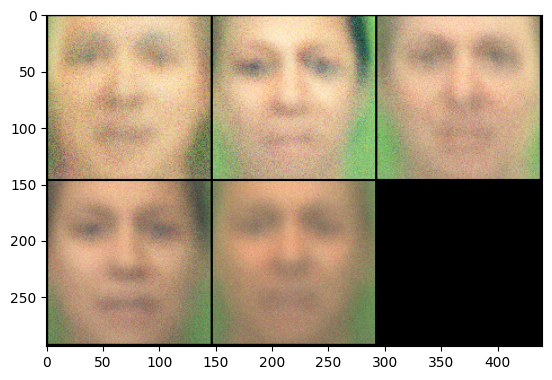



Época: 100
G_loss: 0.917669951915741, D_loss: 0.6156944036483765


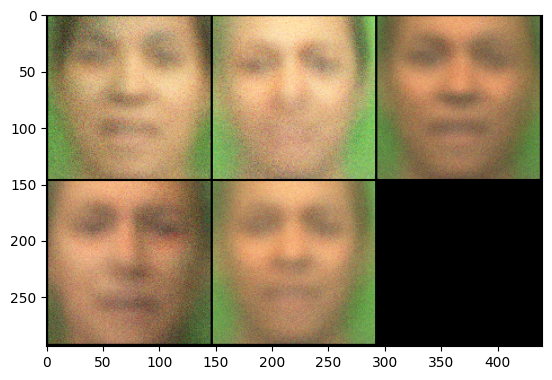

In [ ]:
device = 'cuda' if torch.cuda.is_available() else 'cpu'

for epoch in range(epochs):
  print(f"Época: {epoch + 1}")

  for i, (images, labels) in enumerate(data_loader):
    batch_size = images.shape[0]

    # Definimos tensores de 1s y 0s
    valid = Variable(torch.ones(batch_size)).to(device)
    fake = Variable(torch.zeros(batch_size)).to(device)

    # Definimos nuestras imagenes reales y labels reales
    real_images = Variable(images).to(device)
    labels = Variable(labels).to(device)

    # Ruido gaussiano
    z = Variable(torch.randn(batch_size, z_size)).to(device)

    # Seteamos el generador en modo de entrenamiento
    generator.train()

    # ---------------------------------
    #  Entrenamiento del discriminador
    # ---------------------------------

    optimizer_D.zero_grad()

    # Calculamos la funciones de pérdida para imagenes reales
    real_validity = discriminator(real_images, labels)
    real_loss = criterion(real_validity, valid)

    # Generamos batch de imagenes y labels
    gen_labels = Variable(torch.LongTensor(np.random.randint(0, class_num, batch_size))).to(device)
    gen_images = generator(z, gen_labels)

    # Calculamos la funciones de pérdida para imagenes falsas
    fake_validity = discriminator(gen_images, gen_labels)
    fake_loss = criterion(fake_validity, fake)

    # Se suma las loss y promediamos
    d_loss = (real_loss + fake_loss) * 0.5

    d_loss.backward()
    optimizer_D.step()

    # -----------------------------
    #  Entrenamiento del generador
    # -----------------------------

    optimizer_G.zero_grad()

    # Generamos imagenes falsas
    gen_images = generator(z, gen_labels)
    validity = discriminator(gen_images, gen_labels)

    # Calculamos la función de pérdida de la discrepancia
    g_loss = criterion(validity, valid)

    g_loss.backward()
    optimizer_G.step()

  # Seteamos el modelo en modo de evaluación
  generator.eval()

  print('G_loss: {}, D_loss: {}'.format(g_loss.item(), d_loss.item()))

  # Instanciamos un ruido gaussiano
  z = Variable(torch.randn(class_num-1, z_size)).to(device)

  # Generamos labels entre las clases 0 y 8
  labels = Variable(torch.LongTensor(np.arange(class_num-1))).to(device)

  # Generamos imagenes
  sample_images = generator(z, labels).data.cpu()

  # Se grafican las imagenes
  grid = make_grid(sample_images, nrow=3, normalize=True).permute(1,2,0).numpy()
  plt.imshow(grid)
  plt.show()
  print(f"\n")

# Guardar modelo

In [ ]:
def save_model(name):
  save_path = f"/models/{name}.pt"
  torch.save(generator.state_dict(), save_path)
  print(f'Modelo guardado en {save_path}')

save_model("generatorEncDec_faces_144p")  # Usen el nonbre que quieran

# Carga del modelo


In [ ]:
def load_model(generator_model, path_model):
  device = 'cuda' if torch.cuda.is_available() else 'cpu'
  if device == 'cuda':
    checkpoint = torch.load(path_model)
    generator_model.load_state_dict(checkpoint)
  else:
    checkpoint = torch.load(path_model, map_location=torch.device('cpu'))
    generator_model.load_state_dict(checkpoint)
  return generator_model

In [ ]:
model = EncDec(input_dim=100,
               out_dim=(3,144,144),
               class_num=10).to(device)
ruta = "/models/generatorEncDec_faces_144p.pt"

generator = load_model(model, ruta)

# Sampleo de imagenes

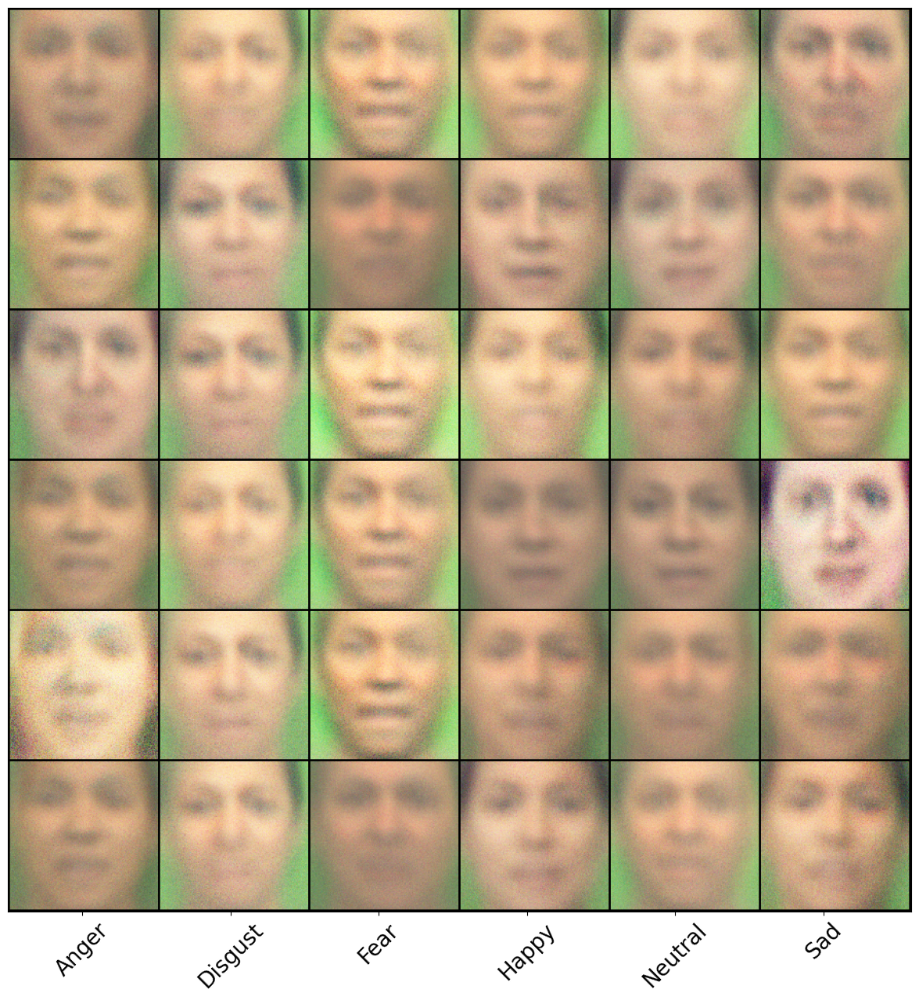

In [ ]:
# Nombre de las clases
class_list = ['Anger', 'Disgust', 'Fear', 'Happy', 'Neutral', 'Sad']

# Instanciamos ruido gaussiano
z = Variable(torch.randn(class_num * class_num, z_size)).to(device)

# Generamos labels
labels = Variable(torch.LongTensor([i for _ in range(class_num) for i in range(class_num)])).to(device)

# Generamos imagenes
sample_images = generator(z, labels).data.cpu()

# Graficamos las imagenes
grid = make_grid(sample_images, nrow=class_num, normalize=True).permute(1,2,0).numpy()
fig, ax = plt.subplots(figsize=(15,15))
ax.imshow(grid)
_ = plt.yticks([])
_ = plt.xticks(np.arange(72, 793, 144), class_list, rotation=45, fontsize=20)